# Plot LFP on good old post trial run of 25-35-40 model

## Libs and load data for

Data required :

From trained model (mcRBM output)
*   obsKeys.npz
*   uniqueStates.npz
*   latentStates.npz

From test post trial (mcRBM output)
*   obsKeyspt.npz
*   uniqueStatespt.npz
*   latentStatespt.npz

From post trial data:
*   GoodOldStates.npy (= Raw manual scoring array with all artefacts marked at 0 - can be found in hdf5 file)

***!!! Make sure the test data from post trial has been inputed in the mcRBM in chronological order!!!***

---



In [ ]:
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
import math
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
import pandas as pd
import h5py
from google.colab import drive

In [ ]:
fs = 1000
window_length = fs*2
epoch_length = int(window_length/fs)

In [ ]:
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# Accessing a Numpy file
latent_states =  np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/latentStates.npz')
unique_states = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/uniqueStates.npz')
obs_keys = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/obsKeys.npz')

latent_states_pt =  np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/latentStatespt.npz')
unique_states_pt = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/uniqueStatespt.npz')
obs_keys_pt = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/obsKeyspt.npz')



In [ ]:
# Get inferred states from model and from test
inferredStates = latent_states['inferredStates']
inferredStates_pt = latent_states_pt['inferredStates']

In [ ]:
theta_power = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/RGS14_Rat6_SD3_CON_2_posttrial5_dataset.npy')[:,8]
delta_power = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/RGS14_Rat6_SD3_CON_2_posttrial5_dataset.npy')[:,9]
manual_scoring = np.load('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/RGS14_Rat6_SD3_CON_2_posttrial5_dataset.npy')[:,1]

print(len(theta_power))
print(len(delta_power))
print(len(manual_scoring))


5272
5272
5272


In [ ]:
# Load states from pt5 (artefact already marked at 0)
with h5py.File('/content/drive/My Drive/Colab Notebooks/GetPlotsFiles/OS_RGS.h5',"r") as hdf:
  group=hdf["RGS14"]["Rat6"]["Rat6_SD3_CON_2_posttrial5"]
  states=group["Mapped_scores"][:]
  features=group["Features"][:]
#states = np.load('RGS14_Rat6_SD3_CON_2_posttrial5_dataset.npy')
upsampled_states = np.repeat(states, 2*fs) # Upsample states to match other data


# Loading HPC raw data and truncate the end to get exact match
hpc_data = loadmat('Rat6_SD3_CON_2_posttrial5_HPC')
hpc_data = hpc_data['HPC']
hpc_data = hpc_data[8*fs:]
raw_hpc = np.ravel(hpc_data)
raw_hpc = raw_hpc[0:len(upsampled_states)]

# Loading PFC raw data and truncate the end to get exact match
pfc_data = loadmat('Rat6_SD3_CON_2_posttrial5_PFC')
pfc_data = pfc_data['PFC']
pfc_data = pfc_data[8*fs:]
raw_pfc = np.ravel(pfc_data)
raw_pfc = raw_pfc[0:len(upsampled_states)]

# Mark as NaN all elements that are either artefact or transitional states(TS) - so that these don't appear in the plots
indices = np.where((upsampled_states != 1) & (upsampled_states != 3) & (upsampled_states != 5))[0]  # Get indices of all epochs that are not in the inferred states epochs (score = 0 and 4)

raw_hpc[indices] = np.nan
raw_pfc[indices] = np.nan

upsampled_states[indices] = 0


# High & low theta

## Getting latent states arrays and downsampling for plots

In [ ]:
# Aligning latent state data with the raw data
upsampled_latent_states = np.repeat(inferredStates_pt, 2*fs, axis = 0)
upsampled_latent_states = np.concatenate((upsampled_latent_states, np.zeros((353*fs*2,2))), axis=0)
ls = np.zeros((len(upsampled_states),2))
n = 0
indices = np.where((upsampled_states != 0) & (upsampled_states != 4))[0]
for i in indices:
  ls[i] = upsampled_latent_states[n]
  n += 1
print(len(ls[:, 0]))



10810000


In [ ]:
print(len(ls[:, 0]))
print(np.unique(ls[:,0]))

10810000
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.
 18. 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 33. 34. 35.
 36. 37. 38. 39. 40. 41. 42. 43. 44. 45.]


In [ ]:
'''# Truncating the end of Raw data to match data from the mcRBM (algorithm truncates the end of the features matrix we feed it)
raw_hpc = raw_hpc[:-353*2*fs]
raw_pfc = raw_pfc[:-353*2*fs]
upsampled_states = upsampled_states[:-353*2*fs]'''

'# Truncating the end of Raw data to match data from the mcRBM (algorithm truncates the end of the features matrix we feed it)\nraw_hpc = raw_hpc[:-353*2*fs]\nraw_pfc = raw_pfc[:-353*2*fs]\nupsampled_states = upsampled_states[:-353*2*fs]'

In [ ]:
print(len(ls[:, 0]))
print(len(raw_hpc))

10810000
10810000


In [ ]:
# Finding the indices epochs belonging to target latent states
indices_hightheta = np.where(np.logical_or(ls[:, 0] == 40, ls[:, 0] == 37))[0]
indices_lowtheta = np.where(np.logical_or(ls[:, 0] == 39, ls[:, 0] == 36))[0]

In [ ]:
print(indices_hightheta)

[ 1024000  1024001  1024002 ... 10709997 10709998 10709999]


In [ ]:
print(len(indices_hightheta)/(2*fs))
print(len(indices_lowtheta)/(2*fs))

143.0
14.0


In [ ]:
len(inferredStates_pt[:,0])

5272

In [ ]:
# Preparing arrays to plot
print(len(raw_hpc))
print(np.max(indices_hightheta))
print(np.max(indices_lowtheta))

hightheta_hpc = np.copy(raw_hpc)
hightheta_pfc = np.copy(raw_pfc)
lowtheta_hpc = np.copy(raw_hpc)
lowtheta_pfc = np.copy(raw_pfc)


maskhigh = np.ones_like(hightheta_hpc, dtype=bool)
maskhigh[indices_hightheta] = False


masklow = np.ones_like(lowtheta_hpc, dtype=bool)
masklow[indices_lowtheta] = False


hightheta_hpc[maskhigh] = np.nan  # Raw HPC with only high theta REM epochs as not NaN
hightheta_pfc[maskhigh] = np.nan # Raw PFC with only high theta REM epochs as not NaN

lowtheta_hpc[masklow] = np.nan # Raw HPC with only low theta REM epochs as not NaN
lowtheta_pfc[masklow] = np.nan # Raw PFC with only low theta REM epochs as not NaN


# Downsampling (So that we can plot intervals of len ~ 400 secs)
raw_hpc = raw_hpc[::5]
hightheta_hpc = hightheta_hpc[::5]
lowtheta_hpc = lowtheta_hpc[::5]

raw_pfc = raw_pfc[::5]
hightheta_pfc = hightheta_pfc[::5]
lowtheta_pfc = lowtheta_pfc[::5]

ls = ls[::5]

new_fs = int(fs/5) # Let's not forget to set a new downsampled sampling frequency

10810000
10709999
10325999


## Plots

2162000


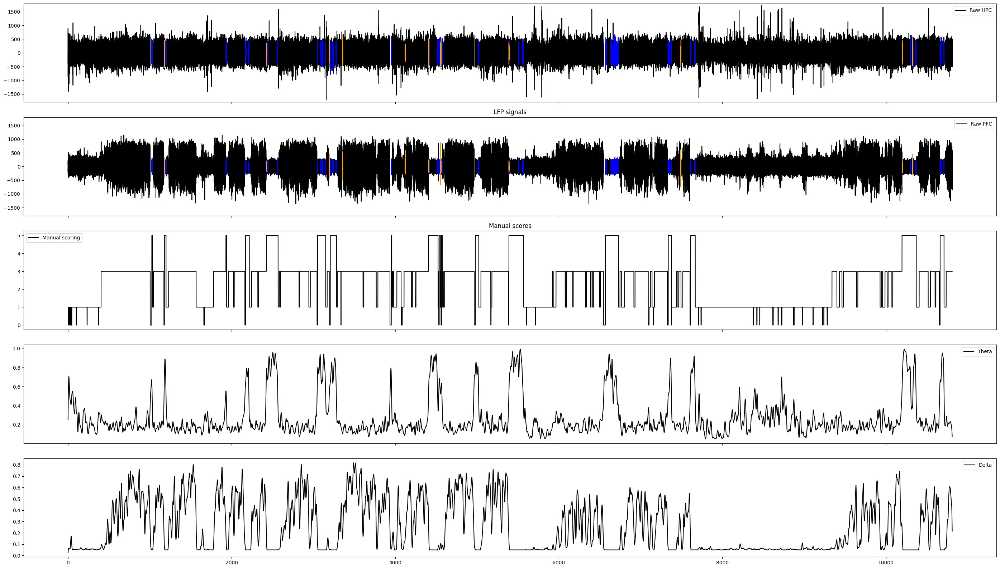

In [ ]:
x = np.arange(len(raw_hpc))/new_fs
times = np.arange(0, len(x))
print(len(times))
# fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize = (28, 16))
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, sharex=True, figsize = (28, 16))                                          # Plot whole LFP signals and manual scores to get an overall view of target areas - cf zoom on these areas below

# Plot data on each subplot
ax1.plot(x[times], raw_hpc[times], label='Raw HPC', color = 'black')
ax1.plot(x[times], hightheta_hpc[times], color = 'blue')
ax1.plot(x[times], lowtheta_hpc[times], color = 'orange')

ax2.plot(x[times], raw_pfc[times], label='Raw PFC', color = 'black')
ax2.plot(x[times], hightheta_pfc[times], color = 'blue')
ax2.plot(x[times], lowtheta_pfc[times], color = 'orange')

#ax3.plot(x[times], ls[:,1][times], label='Manual scoring', color = 'black')
ax3.plot(x[times], ls[:,1][times], label='Manual scoring', color = 'black')

time_f=np.linspace(0,len(features[:,8])*2,len(features[:,8]))
ax4.plot(time_f, features[:,8], label='Theta', color = 'black')
time_del=np.linspace(0,len(features[:,9])*2,len(features[:,9]))
ax5.plot(time_del, features[:,9], label='Delta', color = 'black')


ax2.set_title('LFP signals')
ax3.set_title('Manual scores')
# Add legends
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()
ax5.legend()

ax1.set_ylim([-1800, 1800])  # Adjust the range as needed for HPC
ax2.set_ylim([-1800, 1800])

# Adjust layout to avoid overlap
plt.tight_layout()
plt.savefig('FullLFPs', format='pdf')

# Show the plots
plt.show()

# Blank spaces are either artefacts or manually scored as TS (transition state) (both scored as 0 here)

In [ ]:
print(len(ls[:,1][times]))
print(len(manual_scoring))

2162000
5272


2162000


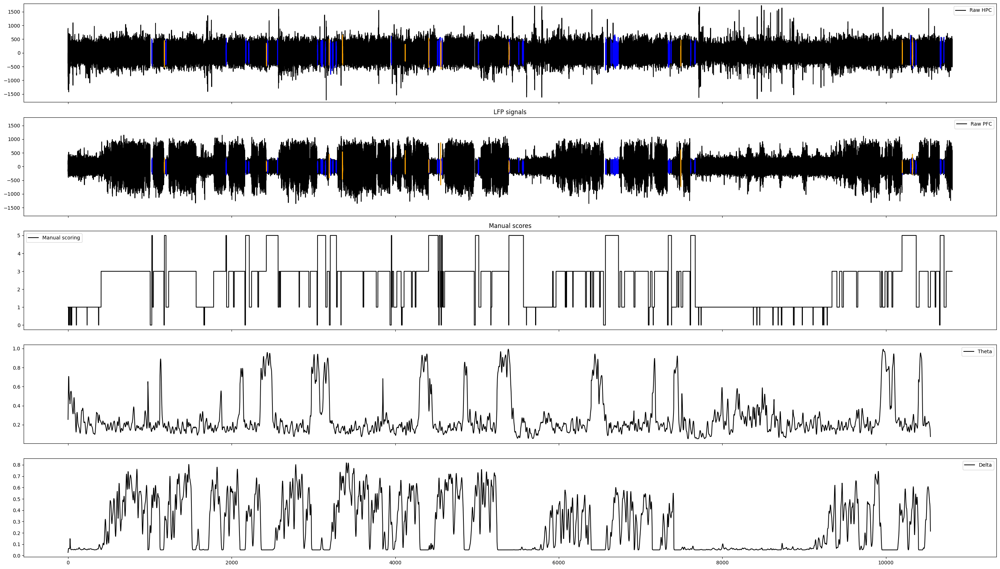

In [ ]:
x = np.arange(len(raw_hpc))/new_fs
times = np.arange(0, len(x))
print(len(times))
# fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize = (28, 16))
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, sharex=True, figsize = (28, 16))
                                        # Plot whole LFP signals and manual scores to get an overall view of target areas - cf zoom on these areas below

# Plot data on each subplot
ax1.plot(x[times], raw_hpc[times], label='Raw HPC', color = 'black')
ax1.plot(x[times], hightheta_hpc[times], color = 'blue')
ax1.plot(x[times], lowtheta_hpc[times], color = 'orange')

ax2.plot(x[times], raw_pfc[times], label='Raw PFC', color = 'black')
ax2.plot(x[times], hightheta_pfc[times], color = 'blue')
ax2.plot(x[times], lowtheta_pfc[times], color = 'orange')

ax3.plot(x[times], ls[:,1][times], label='Manual scoring', color = 'black')
'''ax4.plot(x[times], theta_power[times], label='Theta',color = 'black')
ax5.plot(x[times], delta_power[times], label='Delta',color = 'black')'''


time_f=np.linspace(0,len(theta_power)*2,len(theta_power))
ax4.plot(time_f, theta_power, label='Theta', color = 'black')
time_del=np.linspace(0,len(delta_power)*2,len(delta_power))
ax5.plot(time_del, delta_power, label='Delta', color = 'black')

'''print(time_f)
print(time_del)
print(len(time_f))'''


ax2.set_title('LFP signals')
ax3.set_title('Manual scores')
# Add legends
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()
ax5.legend()

ax1.set_ylim([-1800, 1800])  # Adjust the range as needed for HPC
ax2.set_ylim([-1800, 1800])

# Adjust layout to avoid overlap
plt.tight_layout()
plt.savefig('FullLFPs', format='pdf')

# Show the plots
plt.show()

# Blank spaces are either artefacts or manually scored as TS (transition state) (both scored as 0 here)

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times_range = [5000,6000]  # Time interval in seconds
times = np.arange(new_fs * times_range[0], new_fs * times_range[1])
times_f =  np.arange(times_range[0]//4 , times_range[1]//4 )
times_del =  np.arange(times_range[0]//4 , times_range[1]//4 )

# Define a subset for initial view (e.g., first 1000 data points)
#initial_view_end = 1000

# Create time_f for the x-axis values for the Theta signal
time_f = np.linspace(0, len(features[:, 8]) * 4, len(features[:, 8]))
time_del = np.linspace(0, len(features[:, 9]) * 4, len(features[:, 9]))

# Create traces for each signal
trace1 = go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', name='Raw HPC', line=dict(color='black'))
trace2 = go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', name='High Theta HPC', line=dict(color='blue'))
trace3 = go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', name='Low Theta HPC', line=dict(color='orange'))

trace4 = go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', name='Raw PFC', line=dict(color='black'))
trace5 = go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', name='High Theta PFC', line=dict(color='blue'))
trace6 = go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', name='Low Theta PFC', line=dict(color='orange'))

trace7 = go.Scatter(x=x[times], y=ls[:, 1][times], mode='lines', name='Manual scoring', line=dict(color='black'))

# Create traces for the Theta signal
trace8 = go.Scatter(x=time_f[times_f], y=features[:, 8][times_f], mode='lines', name='Theta Line', line=dict(color='black'))

# Create traces for the Delta signal
trace10 = go.Scatter(x=time_del[times_del], y=features[:, 9][times_del], mode='lines', name='Delta Line', line=dict(color='black'))

# Create subplots
fig = make_subplots(rows=5, cols=1, shared_xaxes=True, subplot_titles=('LFP signals (HPC)', 'LFP signals (PFC)', 'Manual scores', 'Theta Signal','Delta Signal'))

# Add traces to the subplots
fig.add_trace(trace1, row=1, col=1)
fig.add_trace(trace2, row=1, col=1)
fig.add_trace(trace3, row=1, col=1)

fig.add_trace(trace4, row=2, col=1)
fig.add_trace(trace5, row=2, col=1)
fig.add_trace(trace6, row=2, col=1)

fig.add_trace(trace7, row=3, col=1)

# Add Theta signal traces
fig.add_trace(trace8, row=4, col=1)


# Add Delta signal traces
fig.add_trace(trace10, row=5, col=1)



fig.update_yaxes(range=[-1800, 1800], row=1, col=1)
fig.update_yaxes(range=[-1800, 1800], row=2, col=1)

fig.update_layout(height=600, width=800, title_text="LFP and Theta/Delta Signals")

# Show the plot
fig.show()


[1250 1251 1252 1253 1254 1255 1256 1257 1258 1259 1260 1261 1262 1263
 1264 1265 1266 1267 1268 1269 1270 1271 1272 1273 1274 1275 1276 1277
 1278 1279 1280 1281 1282 1283 1284 1285 1286 1287 1288 1289 1290 1291
 1292 1293 1294 1295 1296 1297 1298 1299 1300 1301 1302 1303 1304 1305
 1306 1307 1308 1309 1310 1311 1312 1313 1314 1315 1316 1317 1318 1319
 1320 1321 1322 1323 1324 1325 1326 1327 1328 1329 1330 1331 1332 1333
 1334 1335 1336 1337 1338 1339 1340 1341 1342 1343 1344 1345 1346 1347
 1348 1349 1350 1351 1352 1353 1354 1355 1356 1357 1358 1359 1360 1361
 1362 1363 1364 1365 1366 1367 1368 1369 1370 1371 1372 1373 1374 1375
 1376 1377 1378 1379 1380 1381 1382 1383 1384 1385 1386 1387 1388 1389
 1390 1391 1392 1393 1394 1395 1396 1397 1398 1399 1400 1401 1402 1403
 1404 1405 1406 1407 1408 1409 1410 1411 1412 1413 1414 1415 1416 1417
 1418 1419 1420 1421 1422 1423 1424 1425 1426 1427 1428 1429 1430 1431
 1432 1433 1434 1435 1436 1437 1438 1439 1440 1441 1442 1443 1444 1445
 1446 

In [77]:
print(len(theta_power))
print(len(raw_hpc))

5272
2162000


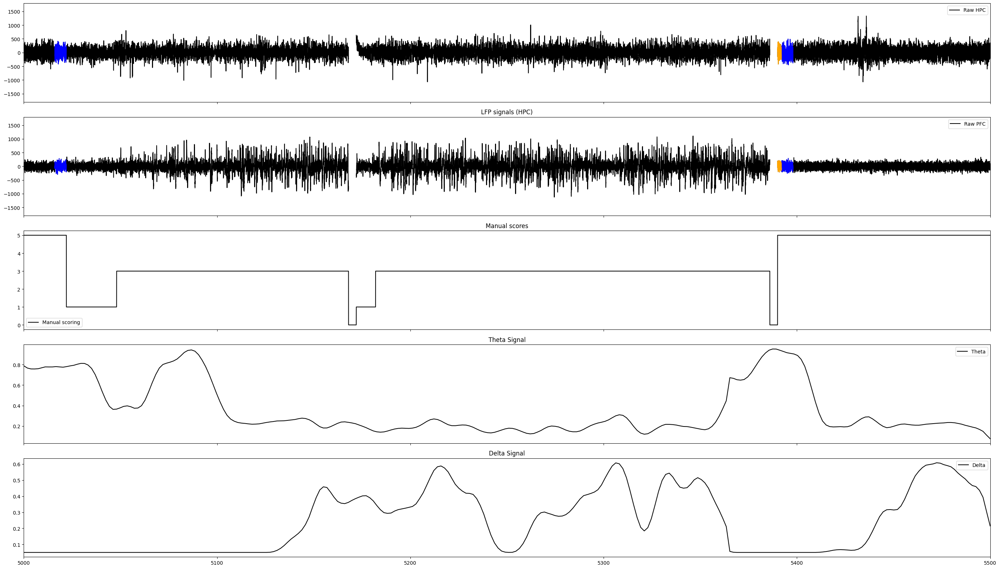

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Calculate time arrays
x = np.arange(len(raw_hpc)) / new_fs
times = np.arange(0, len(x))

# Create subplots
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, sharex=True, figsize=(28, 16))

# Plot data on each subplot
ax1.plot(x[times], raw_hpc[times], label='Raw HPC', color='black')
ax1.plot(x[times], hightheta_hpc[times], color='blue')
ax1.plot(x[times], lowtheta_hpc[times], color='orange')

ax2.plot(x[times], raw_pfc[times], label='Raw PFC', color='black')
ax2.plot(x[times], hightheta_pfc[times], color='blue')
ax2.plot(x[times], lowtheta_pfc[times], color='orange')

ax3.plot(x[times], ls[:, 1][times], label='Manual scoring', color='black')

# Slicing theta and delta power signals for the range 5000 to 5500
range_min = 5000
range_max = 5500

theta_range = theta_power[range_min:range_max]
delta_range = delta_power[range_min:range_max]

# Create time arrays for the sliced ranges
theta_time = np.linspace(range_min, range_max, len(theta_range))
delta_time = np.linspace(range_min, range_max, len(delta_range))

# Plot theta and delta power signals in the specified range
ax4.plot(theta_time, theta_range, label='Theta', color='black')
ax5.plot(delta_time, delta_range, label='Delta', color='black')

# Set titles
ax2.set_title('LFP signals (HPC)')
ax3.set_title('Manual scores')
ax4.set_title('Theta Signal')
ax5.set_title('Delta Signal')

# Add legends
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()
ax5.legend()

# Set y-axis limits for specific subplots
ax1.set_ylim([-1800, 1800])  # Adjust the range as needed for HPC
ax2.set_ylim([-1800, 1800])

# Set x-axis limits to zoom in on the range of 5000 to 5500 for theta and delta signals
ax4.set_xlim([range_min, range_max])
ax5.set_xlim([range_min, range_max])

# Adjust layout to avoid overlap
plt.tight_layout()
plt.savefig('FullLFPs', format='pdf')

# Show the plots
plt.show()


In [ ]:
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Calculate time arrays
x = np.arange(len(raw_hpc)) / new_fs
times_range = [5000, 5500]
times = np.arange(new_fs * times_range[0], new_fs * times_range[1])

# Create time_f and time_del for the x-axis values for the Theta and Delta signals
theta_power_len = len(features[:, 8])
delta_power_len = len(features[:, 9])
time_f = np.linspace(0, theta_power_len * 4, theta_power_len)
time_del = np.linspace(0, delta_power_len * 4, delta_power_len)

# Create the traces for each signal
trace1 = go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', name='Raw HPC', line=dict(color='black'))
trace2 = go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', name='High Theta HPC', line=dict(color='blue'))
trace3 = go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', name='Low Theta HPC', line=dict(color='orange'))

trace4 = go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', name='Raw PFC', line=dict(color='black'))
trace5 = go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', name='High Theta PFC', line=dict(color='blue'))
trace6 = go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', name='Low Theta PFC', line=dict(color='orange'))

trace7 = go.Scatter(x=x[times], y=ls[:, 1][times], mode='lines', name='Manual scoring', line=dict(color='black'))

# Ensure the range is within the length of theta_power and delta_power
theta_range = features[:, 8][range_min // 4:range_max // 4]
delta_range = features[:, 9][range_min // 4:range_max // 4]

# Create traces for the Theta signal
trace8 = go.Scatter(x=time_f[range_min // 4:range_max // 4], y=theta_range, mode='lines', name='Theta Line', line=dict(color='black'))

# Create traces for the Delta signal
trace10 = go.Scatter(x=time_del[range_min // 4:range_max // 4], y=delta_range, mode='lines', name='Delta Line', line=dict(color='black'))

# Create subplots
fig = make_subplots(rows=5, cols=1, shared_xaxes=True, subplot_titles=('LFP signals (HPC)', 'LFP signals (PFC)', 'Manual scores', 'Theta Signal', 'Delta Signal'))

# Add traces to the subplots
fig.add_trace(trace1, row=1, col=1)
fig.add_trace(trace2, row=1, col=1)
fig.add_trace(trace3, row=1, col=1)

fig.add_trace(trace4, row=2, col=1)
fig.add_trace(trace5, row=2, col=1)
fig.add_trace(trace6, row=2, col=1)

fig.add_trace(trace7, row=3, col=1)

# Add Theta signal traces
fig.add_trace(trace8, row=4, col=1)

# Add Delta signal traces
fig.add_trace(trace10, row=5, col=1)

# Set y-axis limits for specific subplots
fig.update_yaxes(range=[-1800, 1800], row=1, col=1)
fig.update_yaxes(range=[-1800, 1800], row=2, col=1)

# Set x-axis limits to zoom in on the range of 5000 to 5500 for theta and delta signals
fig.update_xaxes(range=[range_min, range_max], row=4, col=1)
fig.update_xaxes(range=[range_min, range_max], row=5, col=1)

fig.update_layout(height=1000, width=1200, title_text="LFP and Theta/Delta Signals")

# Show the plot
fig.show()


In [ ]:
print(len(theta_power))
print(len(inferredStates_pt[:,0]))

5272
5272


{36: array([0.1096183 , 0.10562426, 0.1164327 , 0.14266619]), 37: array([0.50096524, 0.64567197, 0.53882793, 0.58381104, 0.62162101,
       0.57886073, 0.41733719, 0.65260621, 0.55249292, 0.4515653 ,
       0.63428088, 0.53407679, 0.50835132, 0.55899028, 0.58952828,
       0.6082626 , 0.61748026, 0.61643078, 0.55831528]), 39: array([0.71616559, 0.71857469, 0.47917367, 0.63124648, 0.52307319,
       0.53618624, 0.56303334, 0.56143424, 0.66243174, 0.39846112]), 40: array([0.65236112, 0.60458082, 0.52746836, 0.68848639, 0.59597016,
       0.55423554, 0.52042261, 0.62965098, 0.64993394, 0.67746906,
       0.67270241, 0.67896673, 0.66242996, 0.74838972, 0.69128865,
       0.65006492, 0.63304633, 0.63508051, 0.64857714, 0.66321621,
       0.66863441, 0.66165132, 0.65541581, 0.65567665, 0.67323826,
       0.6464771 , 0.66706228, 0.68825707, 0.69489551, 0.65747787,
       0.63682354, 0.63451087, 0.65272134, 0.67856776, 0.66284993,
       0.68418007, 0.57627057, 0.67830985, 0.69711517, 0.642987

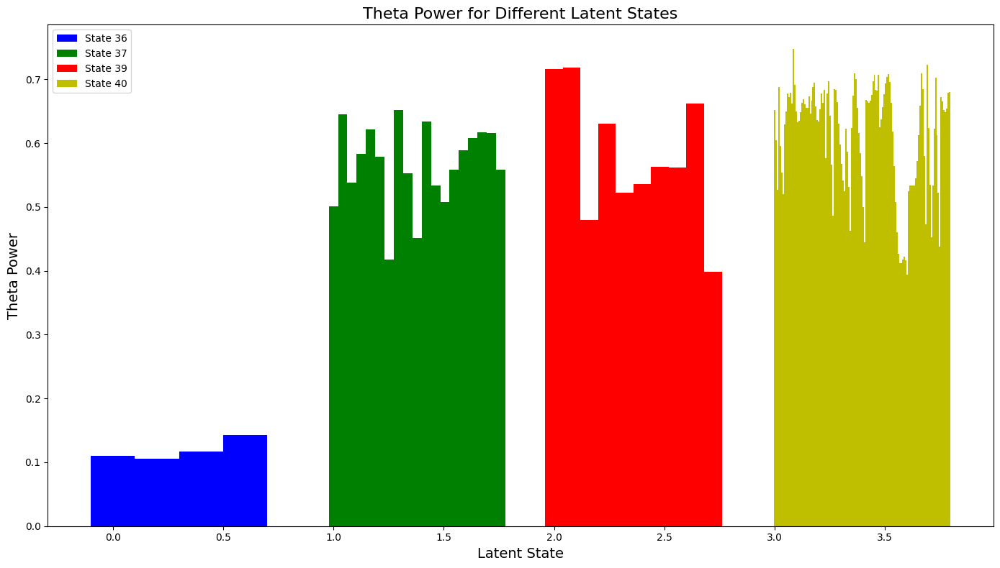

In [ ]:

# Define latent states of interest
latent_states = [36, 37, 39, 40]

# Extract theta power values for each latent state using the indices
theta_power_by_state = {state: theta_power[np.where(inferredStates_pt[:, 0] == state)[0]] for state in latent_states}
print(theta_power_by_state)
print(np.unique(inferredStates[:,0]))

# Prepare data for plotting
# Create a list of theta power values for each latent state
data = [theta_power_by_state[state] for state in latent_states]

# Plotting
fig, ax = plt.subplots(figsize=(14, 8))

# Parameters for bar graph
bar_width = 0.8
index = np.arange(len(latent_states))

# Colors for bars
colors = ['b', 'g', 'r', 'y']

# Plot bars for each latent state
for idx, state in enumerate(latent_states):
    theta_powers = data[idx]
    if len(theta_powers) == 0:
        print(f"No theta power values found for state {state}. Skipping.")
        continue

    positions = index[idx] + np.arange(len(theta_powers)) * (bar_width / len(theta_powers))

    ax.bar(positions, theta_powers, width=bar_width / len(theta_powers), label=f'State {state}', color=colors[idx % len(colors)])

# Add labels and title
ax.set_xlabel('Latent State', fontsize=14)
ax.set_ylabel('Theta Power', fontsize=14)
ax.set_title('Theta Power for Different Latent States', fontsize=16)
ax.legend()

# Show plot
plt.tight_layout()
plt.show()


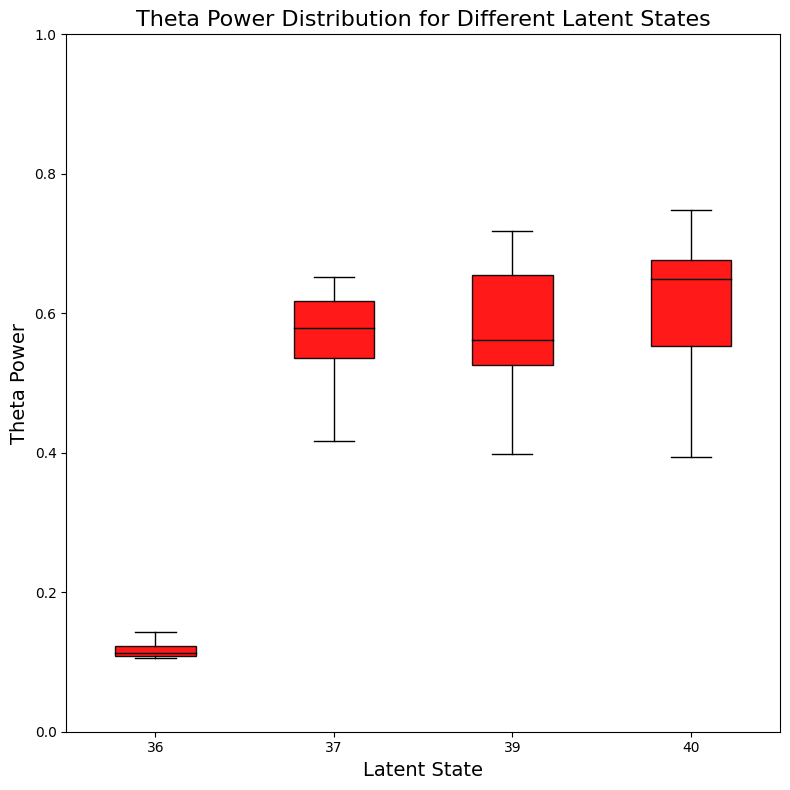

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming inferredStates_pt and theta_power are already defined and aligned

# Define latent states of interest
latent_states = [36, 37, 39, 40]

# Extract theta power values for each latent state using the indices
theta_power_by_state = {state: theta_power[np.where(inferredStates_pt[:, 0] == state)[0]] for state in latent_states}

# Prepare data for box plot
data = [theta_power_by_state[state] for state in latent_states]

# Plotting
fig, ax = plt.subplots(figsize=(8, 8))

# Create box plot
box = ax.boxplot(data, labels=latent_states, patch_artist=True, notch=False)
for patch in box['boxes']:
    patch.set_facecolor('red')
    patch.set_alpha(0.9)

# Set the median line color to black
for median in box['medians']:
    median.set_color('black')

# Add labels and title
ax.set_xlabel('Latent State', fontsize=14)
ax.set_ylabel('Theta Power', fontsize=14)
ax.set_title('Theta Power Distribution for Different Latent States', fontsize=16)

# Set consistent y-axis limits for better comparison
ax.set_ylim(0, 1)

# Show plot
plt.tight_layout()
plt.show()



In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [4540,4560]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize = (28, 16))                                           # Plot whole LFP signals and manual scores to get an overall view of target areas - cf zoom on these areas below

# Plot data on each subplot
ax1.plot(x[times], raw_hpc[times], label='Raw HPC', color = 'black')
ax1.plot(x[times], hightheta_hpc[times], color = 'blue')
ax1.plot(x[times], lowtheta_hpc[times], color = 'orange')

ax2.plot(x[times], raw_pfc[times], label='Raw PFC', color = 'black')
ax2.plot(x[times], hightheta_pfc[times], color = 'blue')
ax2.plot(x[times], lowtheta_pfc[times], color = 'orange')

ax3.plot(x[times], ls[:,1][times], label='Manual scoring', color = 'black')


ax2.set_title('Full LFP signals - blue = high theta, orange = low theta REM')
ax3.set_title('Manual scores')
# Add legends
ax1.legend()
ax2.legend()
ax3.legend()

ax1.set_ylim([-1800, 1800])  # Adjust the range as needed for HPC
ax2.set_ylim([-1800, 1800])

# Adjust layout to avoid overlap
plt.tight_layout()
plt.savefig('FullLFPs.pdf', format='pdf')

# Show the plots
plt.show()

# Blank spaces are either artefacts or manually scored as TS (transition state) (both scored as 0 here)

### **Zoom on different regions** (Windows of 450 secs max for the plots to show)

#### 1100  - 1500

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [1100, 1500]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_yaxes(range=[-1500, 1500], row=1, col=1)
fig.update_yaxes(range=[-1500, 1500], row=2, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')

plt.savefig('FirstRegion.pdf', format='pdf')

fig.show()

#### 2350 - 2850

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [2350, 2850]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')
fig.show()

#### 4080 - 4480

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [4080, 4480]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')
fig.show()

#### 5800 - 6200

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [5800, 6200]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')
fig.show()

#### 7550-7950

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [7550, 7950]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_yaxes(range=[-1500, 1500], row=1, col=1)
fig.update_yaxes(range=[-1500, 1500], row=2, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')
fig.show()

#### 8250-8750

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [8250, 8750]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_hpc[times], mode='lines', line=dict(color='blue'), name='High Theta HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_hpc[times], mode='lines', line=dict(color='orange'), name='Low Theta HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hightheta_pfc[times], mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lowtheta_pfc[times], mode='lines', line=dict(color='orange'), showlegend=False), row=2, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')
fig.show()

# High & low theta AND high & low wake

## Getting latent states arrays and downsampling for plots

In [ ]:
# Aligning latent state data with the raw data
upsampled_latent_states = np.repeat(inferredStates_pt, 2*fs, axis = 0)
upsampled_latent_states = np.concatenate((upsampled_latent_states, np.zeros((353*fs*2,2))), axis=0)
ls = np.zeros((len(upsampled_states),2))
n = 0
indices = np.where((upsampled_states != 0) & (upsampled_states != 4))[0]
for i in indices:
  ls[i] = upsampled_latent_states[n]
  n += 1

In [ ]:
# No truncating apart from in train model
# Truncating the end of Raw data to match data from the mcRBM (algorithm truncates the end of the features matrix we feed it)             ############ RELAOD DATA EVERY TIME ##############
#raw_hpc = raw_hpc[:-353*2*fs]
#raw_pfc = raw_pfc[:-353*2*fs]
#upsampled_states = upsampled_states[:-353*2*fs]

In [ ]:
# Finding the indices epochs belonging to target latent states
indices_hwlt = np.where(ls[:, 0] == 48)[0]
indices_lwht = np.where(ls[:, 0] == 30)[0]
indices_lwlt = np.where(np.logical_or(ls[:, 0] == 44, ls[:, 0] == 45))[0]
indices_hwht = np.where(ls[:, 0] == 23)[0]

In [ ]:
print('len indices_hwlt = ', len(indices_hwlt)/(2*fs))     # Check with lengths that you have selected the latent states you were thinking of
print('len indices_lwht = ', len(indices_lwht)/(2*fs))
print('len indices_lwlt = ', len(indices_lwlt)/(2*fs))
print('len indices_hwht = ', len(indices_hwht)/(2*fs))

In [ ]:
# Preparing arrays to plot
hwlt_hpc = np.copy(raw_hpc)
hwlt_pfc = np.copy(raw_pfc)

lwht_hpc = np.copy(raw_hpc)
lwht_pfc = np.copy(raw_pfc)

lwlt_hpc = np.copy(raw_hpc)
lwlt_pfc = np.copy(raw_pfc)

hwht_hpc = np.copy(raw_hpc)
hwht_pfc = np.copy(raw_pfc)

maskhwlt = np.ones_like(hwlt_hpc, dtype=bool)
masklwht = np.ones_like(hwlt_hpc, dtype=bool)
masklwlt = np.ones_like(hwlt_hpc, dtype=bool)
maskhwht = np.ones_like(hwlt_hpc, dtype=bool)

maskhwlt[indices_hwlt] = False
masklwht[indices_lwht] = False
masklwlt[indices_lwlt] = False
maskhwht[indices_hwht] = False

hwlt_hpc[maskhwlt] = np.nan  # Raw HPC with only high wake/low theta REM epochs as not NaN
hwlt_pfc[maskhwlt] = np.nan # Raw PFC with only high wake/low theta REM epochs as not NaN

lwht_hpc[masklwht] = np.nan
lwht_pfc[masklwht] = np.nan

lwlt_hpc[masklwlt] = np.nan
lwlt_pfc[masklwlt] = np.nan

hwht_hpc[maskhwht] = np.nan
hwht_pfc[maskhwht] = np.nan

# Downsampling (So that we can plot intervals of len ~ 400 secs)
raw_hpc = raw_hpc[::5]
hwlt_hpc = hwlt_hpc[::5]
lwht_hpc = lwht_hpc[::5]
lwlt_hpc = lwlt_hpc[::5]
hwht_hpc = hwht_hpc[::5]

raw_pfc = raw_pfc[::5]
hwlt_pfc = hwlt_pfc[::5]
lwht_pfc = lwht_pfc[::5]
lwlt_pfc = lwlt_pfc[::5]
hwht_pfc = hwht_pfc[::5]

ls = ls[::5]

new_fs = int(fs/5) # Let's not forget to set a new downsampled sampling frequency

## Plots

In [ ]:
x = np.arange(len(raw_hpc))/new_fs
times = np.arange(0, len(x))
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize = (28, 16))                                           # Plot whole LFP signals and manual scores to get an overall view of target areas - cf zoom on these areas below

# Plot data on each subplot
ax1.plot(x[times], raw_hpc[times], label='Raw HPC', color = 'black')
ax1.plot(x[times], hwht_hpc[times], label = 'high wake high theta', color = 'red')
ax1.plot(x[times], lwht_hpc[times], label = 'low wake high theta', color = 'orange')
ax1.plot(x[times], hwlt_hpc[times], label = 'high wake low theta', color = 'blue')
ax1.plot(x[times], lwlt_hpc[times], label = 'low wake low theta', color = '#000099')

ax2.plot(x[times], raw_pfc[times], label='Raw PFC', color = 'black')
ax2.plot(x[times], hwht_pfc[times], color = 'red')
ax2.plot(x[times], lwht_pfc[times], color = 'orange')
ax2.plot(x[times], hwlt_pfc[times], color = 'blue')
ax2.plot(x[times], lwlt_pfc[times], color = '#000099')

ax3.plot(x[times], ls[:,1][times], label='Manual scoring', color = 'black')


ax2.set_title('LFP signals')
ax3.set_title('Manual scores')
# Add legends
ax1.legend()
ax2.legend()
ax3.legend()

ax1.set_ylim([-1800, 1800])  # Adjust the range as needed for HPC
ax2.set_ylim([-1800, 1800])

# Adjust layout to avoid overlap
plt.tight_layout()
#plt.savefig('FullLFPs', format='pdf')

# Show the plots
plt.show()

# Blank spaces are either artefacts or manually scored as TS (transition state) (both scored as 0 here)

#### 1100  - 1500

In [ ]:
x = np.arange(len(raw_hpc)) / new_fs
times = [1250, 1440]  # Time interval in seconds
times = np.arange(new_fs * times[0], new_fs * times[1])

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("HPC", "PFC", "Manual scoring"))

# HPC
fig.add_trace(go.Scatter(x=x[times], y=raw_hpc[times], mode='lines', line=dict(color='black'), name='Raw LFP'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hwht_hpc[times], mode='lines', line=dict(color='red'), name='High theta high wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lwht_hpc[times], mode='lines', line=dict(color='orange'), name='High theta low wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hwlt_hpc[times], mode='lines', line=dict(color='blue'), name='Low Theta high wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lwlt_hpc[times], mode='lines', line=dict(color='#000099'), name='Low Theta low wake HPC'), row=1, col=1)

# PFC
fig.add_trace(go.Scatter(x=x[times], y=raw_pfc[times], mode='lines', line=dict(color='black'), showlegend=False), row=2, col=1,)
fig.add_trace(go.Scatter(x=x[times], y=hwht_pfc[times], mode='lines', line=dict(color='red'), name='High theta high wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lwht_pfc[times], mode='lines', line=dict(color='orange'), name='High theta low wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=hwlt_pfc[times], mode='lines', line=dict(color='blue'), name='Low Theta high wake HPC'), row=1, col=1)
fig.add_trace(go.Scatter(x=x[times], y=lwlt_pfc[times], mode='lines', line=dict(color='#000099'), name='Low Theta low wake HPC'), row=1, col=1)

# States
fig.add_trace(go.Scatter(x=x[times], y=np.array(ls[:, 1])[times], mode='lines', line=dict(color='black'), showlegend=False), row=3, col=1)

fig.update_xaxes(showticklabels=True, row=1, col=1)
fig.update_xaxes(showticklabels=True, row=2, col=1)
fig.update_xaxes(showticklabels=True, row=3, col=1)

fig.update_yaxes(range=[-1500, 1500], row=1, col=1)
fig.update_yaxes(range=[-1500, 1500], row=2, col=1)

fig.update_layout(height=1600, width=2400, title_text="High and low theta REM on LFP signals ", xaxis_title='Time (s)')

plt.savefig('FirstRegion.pdf', format='pdf')

fig.show()